In [1]:
import numpy as np
import matplotlib.pyplot as plt
import trimesh as tr
import math
import torch
import mesh_to_sdf
import pytorch3d

In [2]:
m = tr.load("1000F.stl")
m.show()

In [3]:
direction = [0, 0, 1]
center = [0, 0, 0]

m.apply_transform(tr.transformations.rotation_matrix(math.pi, direction, center))
m.show()

In [4]:
vm = m.voxelized(0.8) 
vm.show()

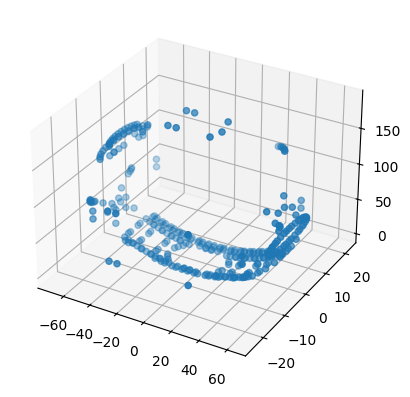

In [5]:
points_mesh = tr.convex.hull_points(m)
tr.points.plot_points(points_mesh)

In [6]:
center_mass = m.center_mass
query_points = np.array([[center_mass],[[3,3,3]]])
for point in query_points:
    print(
        "SDF{0} = {1}".format(point[0],mesh_to_sdf.mesh_to_sdf(m,point)[0])
)

SDF[-3.86092524 -3.224948   75.04906666] = 6.041430950164795
SDF[3. 3. 3.] = 0.8116340637207031


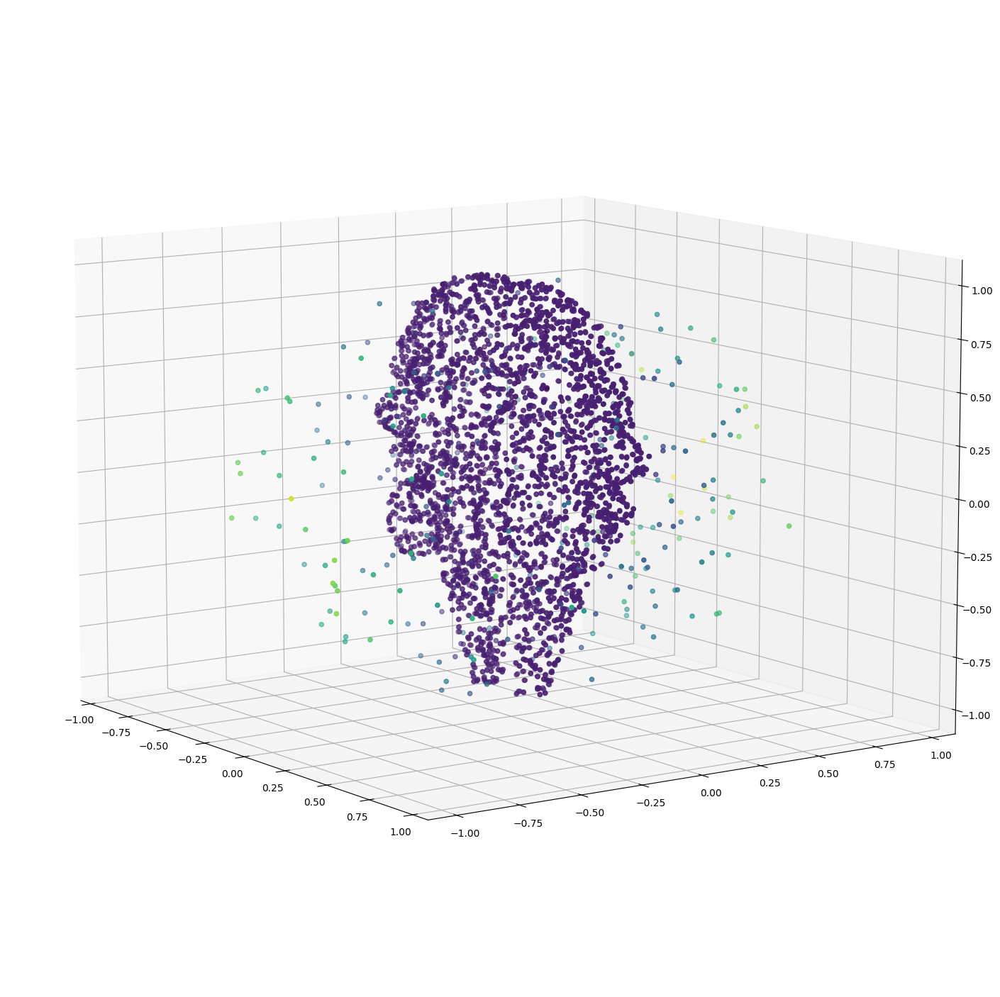

In [7]:
points, sdf = mesh_to_sdf.sample_sdf_near_surface(m, number_of_points=5000)
fig = plt.figure(figsize=(20, 18))
ax = fig.add_subplot(111, projection="3d")
ax.view_init(elev=10, azim=-35)
ax.scatter(points[:, 0], points[:, 1], zs=-points[:, 2], c=sdf)